# Text-Analysis

## TF-IDF Vectorization & Clustering

### Installing Libraries

In [1]:
import numpy as np
import pandas as pd
import re
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA, TruncatedSVD
from sklearn.metrics import silhouette_score, davies_bouldin_score, adjusted_rand_score
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from sklearn.metrics.pairwise import cosine_similarity
from scipy.cluster.hierarchy import linkage, dendrogram
!pip install kaleido
import kaleido


In [2]:
import gensim

### Load the Dataset

In [3]:
with open('dataset.json', 'r') as file:
    data = pd.read_json(file)

### Preprocessing Textual Data

In [4]:
from nltk import sent_tokenize
from gensim.utils import simple_preprocess
from nltk.stem import WordNetLemmatizer
from textblob import TextBlob
from nltk.corpus import stopwords
import nltk

nltk.download('stopwords')
nltk.download('wordnet')
stop_words = set(stopwords.words('english'))
lemmatizer = WordNetLemmatizer()

preprocessed_text = []
def preprocess_text(text):
    # Removing URL
    text = re.sub(r'http\S+', '', text)
    # Checking Spelling Errors
    # text = str(TextBlob(text).correct())
    # Stopword Removal and Word Lemmatization
    text = ' '.join(lemmatizer.lemmatize(word, pos='v') for word in text.split() if word not in stop_words)
    # Preprocessing Textual Data
    text = simple_preprocess(text)

    return text

data['processed_text'] = data['text'].apply(preprocess_text)
preprocessed_text = list(data['processed_text'])

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/muhammadsalmanmalik/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/muhammadsalmanmalik/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [5]:
preprocessed_text

[['running',
  'business',
  'mean',
  'juggle',
  'countless',
  'administrative',
  'tasks',
  'amaze',
  'hr',
  'tech',
  'tool',
  'streamline',
  'operations',
  'check',
  'hrtech'],
 ['liz',
  'truss',
  'walk',
  'linger',
  'shadow',
  'predecessor',
  'from',
  'charlatan',
  'chancer',
  'worst',
  'nightmare',
  'catch',
  'her',
  'politics'],
 ['the',
  'uk',
  'brace',
  'war',
  'government',
  'buildings',
  'london',
  'raise',
  'ukraine',
  'flag',
  'michael',
  'seem',
  'ukrainewashed',
  'truth',
  'need',
  'prepared',
  'warpreparedness'],
 ['marrying',
  'second',
  'third',
  'cousin',
  'remove',
  'taboo',
  'might',
  'think',
  'genetics',
  'science',
  'provide',
  'interest',
  'insights',
  'family',
  'connections',
  'familytree',
  'geneticfacts'],
 ['it',
  'truly',
  'disgraceful',
  'indian',
  'national',
  'congress',
  'stoop',
  'dirty',
  'politics',
  'let',
  'stand',
  'unethical',
  'behavior'],
 ['the',
  'school',
  'teach',
  'kid'

### Word2Vec Vectorization

In [6]:
model = gensim.models.Word2Vec(
    window=10,
    min_count=2
)
model.build_vocab(preprocessed_text)
model.train(preprocessed_text, total_examples=model.corpus_count, epochs=model.epochs)
model.wv.get_normed_vectors()

array([[-0.0123837 ,  0.14497328, -0.04472261, ..., -0.05008386,
         0.20818926,  0.01300226],
       [-0.1671176 ,  0.10377461,  0.03328698, ..., -0.05963953,
        -0.06733964,  0.05562065],
       [ 0.03634129,  0.17883979, -0.12481306, ..., -0.09324948,
         0.07533552,  0.07001092],
       ...,
       [-0.12790287,  0.10044681,  0.07018677, ..., -0.18813193,
         0.03064944,  0.10893553],
       [-0.14727147,  0.08499204,  0.08652742, ..., -0.16464916,
         0.00809528,  0.11232948],
       [-0.07026638,  0.14674394,  0.14196071, ..., -0.05967289,
         0.16308068, -0.02788544]], dtype=float32)

In [7]:
words = model.wv.index_to_key

In [8]:
words

['business',
 'health',
 'it',
 'the',
 'let',
 'yhawkins',
 'vote',
 'check',
 'make',
 'time',
 'politics',
 'support',
 'can',
 'get',
 'top',
 'like',
 'we',
 'science',
 'new',
 'need',
 'show',
 'don',
 'social',
 'love',
 'us',
 'every',
 'climate',
 'btsbbmas',
 'artist',
 'keep',
 'take',
 'here',
 'bbmas',
 'world',
 'hey',
 'see',
 'you',
 'join',
 'mental',
 'this',
 'just',
 'healthcare',
 'army',
 'change',
 'best',
 'people',
 'rt',
 'latest',
 'work',
 'to',
 'bts',
 'impact',
 'stay',
 'help',
 'crucial',
 're',
 'miss',
 'together',
 'ready',
 'voting',
 'cop',
 'energy',
 'high',
 'wait',
 'real',
 'learn',
 'care',
 'is',
 'one',
 'focus',
 'power',
 'go',
 'group',
 'important',
 'low',
 'what',
 'more',
 'now',
 'prioritize',
 'in',
 'right',
 'news',
 'game',
 'from',
 'everyone',
 'who',
 'issue',
 'believe',
 'team',
 'find',
 'come',
 'bring',
 'future',
 'looking',
 'success',
 'day',
 'out',
 'award',
 'today',
 'cast',
 'way',
 'they',
 'use',
 'well',
 'co

### Dimentionality Reduction

### PCA

In [9]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(model.wv.get_normed_vectors())
X_pca.shape

(48226, 2)

In [10]:
import plotly.express as px

df_pca = pd.DataFrame(X_pca, columns=['PC_1', 'PC_2'])
df_pca['Word'] = words

# Create the scatter plot
fig = px.scatter(df_pca, x='PC_1', y='PC_2', hover_data='Word', title="")

# Show the plot with word labels
fig.update_traces(textposition='top center', marker=dict(size=7, opacity=0.6))
fig.update_layout(
    title={
        "text": "Principle Component in 2 Dimension",         # Title text
        "font": {"size": 20, "color": "black"},                # Font size and color
        "x": 0.5,                                             # Center align (0: left, 0.5: center, 1: right)
    }
)
# Show the figure
fig.show()
fig.write_image("Principle Component in 2 Dimension.png")

### t-SNE

In [17]:
import numpy as np
import pandas as pd
from sklearn.manifold import TSNE
import plotly.express as px

# Assuming `model.wv.get_normed_vectors()` is your word vectors from Word2Vec

# Apply t-SNE to reduce the dimensionality of the word vectors
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(model.wv.get_normed_vectors())

# Create a DataFrame with the t-SNE results
df_tsne = pd.DataFrame(X_tsne, columns=['TSNE_1', 'TSNE_2'])

# Add the words from your model's vocabulary
words = model.wv.index_to_key
df_tsne['Word'] = words

# Create the scatter plot with word labels
fig = px.scatter(df_tsne, x='TSNE_1', y='TSNE_2', hover_data='Word', title="t-SNE of Word Vectors")

# Show the plot with word labels
fig.update_traces(textposition='top center', marker=dict(size=7, opacity=0.6))
fig.update_layout(
    title={
        "text": "t-SNE in 2 Dimension",         # Title text
        "font": {"size": 20, "color": "black"},                # Font size and color
        "x": 0.5,                                             # Center align (0: left, 0.5: center, 1: right)
    }
)
fig.show()
fig.write_image("t-SNE in 2 Dimension.png")

### Choosing Value of K for PCA

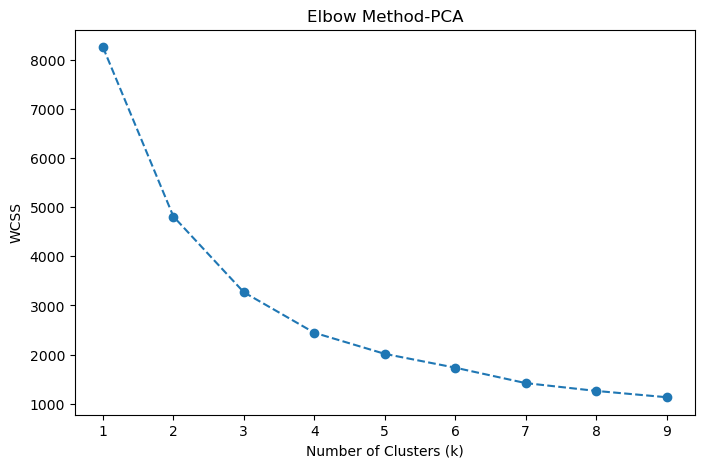

In [47]:

wcss = []
k_values = range(1, 10)
for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=0)
    kmeans.fit(X_pca)
    wcss.append(kmeans.inertia_)  # WCSS for current k

# Plot the Elbow Graph
plt.figure(figsize=(8, 5))
plt.plot(k_values, wcss, marker='o', linestyle='--')
plt.title("Elbow Method-PCA")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("WCSS")
plt.show()


### Choosing Value of K for t-SNE

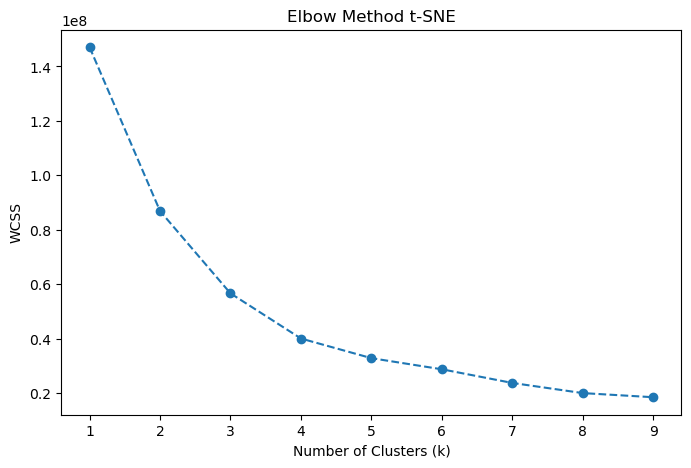

In [48]:

wcss = []
k_values = range(1, 10)
for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=0)
    kmeans.fit(X_tsne)
    wcss.append(kmeans.inertia_)  # WCSS for current k

# Plot the Elbow Graph
plt.figure(figsize=(8, 5))
plt.plot(k_values, wcss, marker='o', linestyle='--')
plt.title("Elbow Method t-SNE")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("WCSS")
plt.show()

In [30]:
n_clusters = 3
kmeans_pca = KMeans(n_clusters=n_clusters, random_state=42)
kmeans_pca.fit(X_pca)

# Step 4: Evaluate and visualize the clusters
kmeans_labels_pca = kmeans_pca.labels_
print(kmeans_labels_pca)

[1 1 1 ... 0 0 1]


In [38]:
n_clusters = 3
kmeans_tsne = KMeans(n_clusters=n_clusters, random_state=42)
kmeans_tsne.fit(X_tsne)

# Step 4: Evaluate and visualize the clusters
kmeans_labels_tsne = kmeans_tsne.labels_

           PC_1      PC_2  Cluster           Text
0      0.601916  0.295273        1       business
1      0.574949  0.337666        1         health
2      0.693128 -0.074775        1             it
3      0.577530 -0.080117        1            the
4      0.690848 -0.159874        2            let
...         ...       ...      ...            ...
48221 -0.219300  0.182477        0    paulstamets
48222 -0.000924  0.270654        1        burdens
48223 -0.254496  0.146263        0  prostatefossa
48224 -0.250859  0.125472        0            pae
48225  0.271287  0.468450        1   smithwhitney

[48226 rows x 4 columns]


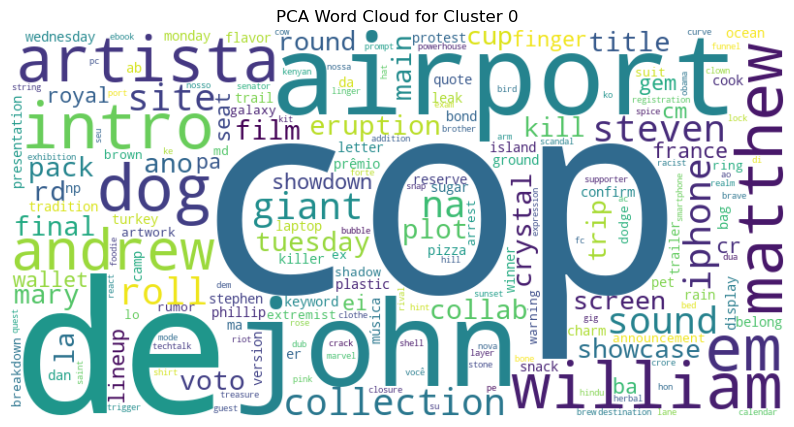

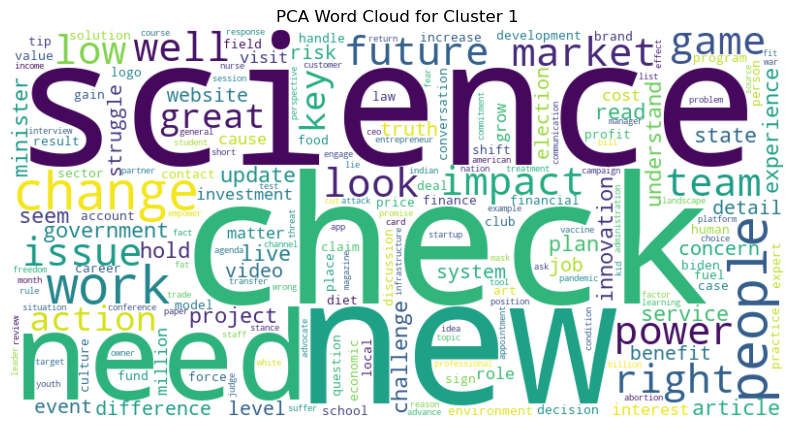

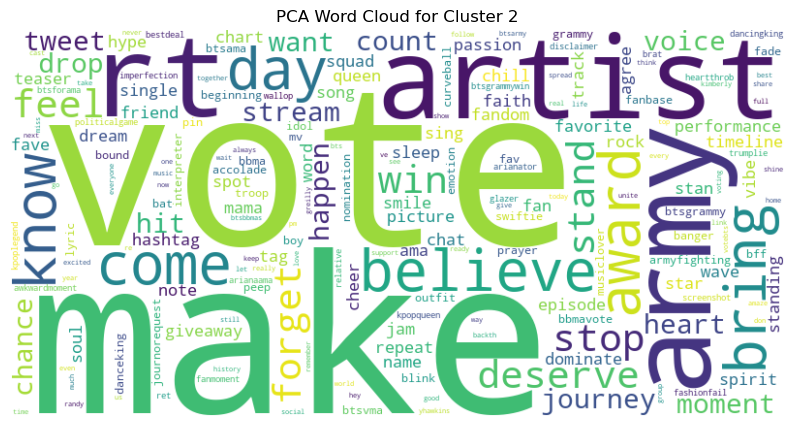

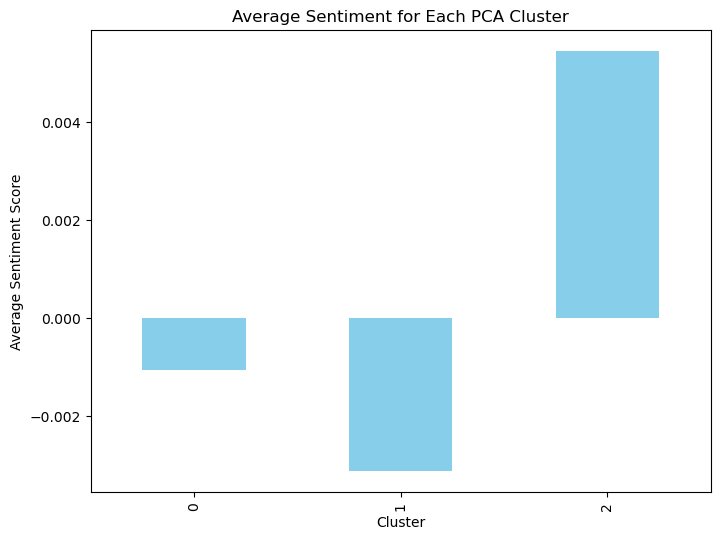

In [36]:
# PCA Visualization
import plotly.express as px
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import pandas as pd

df_pca = pd.DataFrame(X_pca, columns=["PC_1", "PC_2"])
df_pca["Cluster"] = kmeans_labels_pca
df_pca["Text"] = words


print(df_pca)
# Step 5: Generate Word Cloud for Each Cluster
for cluster_id in range(n_clusters):
    # Get the texts belonging to the current cluster
    cluster_texts = df_pca[df_pca['Cluster'] == cluster_id]['Text']
    all_words = ' '.join(cluster_texts)

    # Create a word cloud for the current cluster
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_words)

    # Plot the word cloud
    plt.figure(figsize=(10, 6))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f"PCA Word Cloud for Cluster {cluster_id}")
    plt.show()

# Step 6: Sentiment Analysis for Each Cluster
# Using VADER Sentiment
analyzer = SentimentIntensityAnalyzer()

# Function to get average sentiment for each document in a cluster
def get_sentiment_score(text):
    return analyzer.polarity_scores(text)['compound']

# Add sentiment scores to the DataFrame
df_pca['Sentiment'] = df_pca['Text'].apply(get_sentiment_score)

# Visualizing average sentiment per cluster
average_sentiment = df_pca.groupby('Cluster')['Sentiment'].mean()

# Plot average sentiment for each cluster
average_sentiment.plot(kind='bar', figsize=(8, 6), color='skyblue', title='Average Sentiment for Each PCA Cluster')
plt.ylabel('Average Sentiment Score')
plt.show()

# Step 8: Visualize the UMAP clusters in 2D with cluster color-coding
fig = px.scatter(df_pca, x="PC_1", y="PC_2", color="Cluster",
                title="PCA Clusters",
                hover_data={"Text": True, "Cluster": True})
fig.update_layout(
    title={
        "text": "PCA Clusters using K-Means",         # Title text
        "font": {"size": 20, "color": "black"},                # Font size and color
        "x": 0.5,                                             # Center align (0: left, 0.5: center, 1: right)
    }
)
fig.show()
fig.write_image("PCA Clusters with K-means.png")


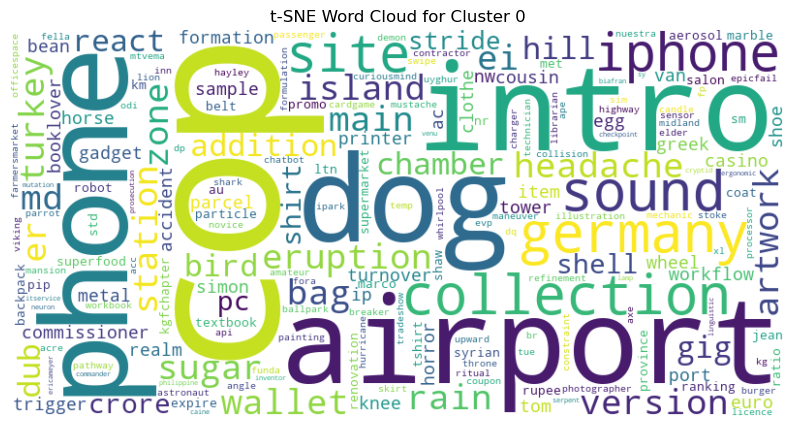

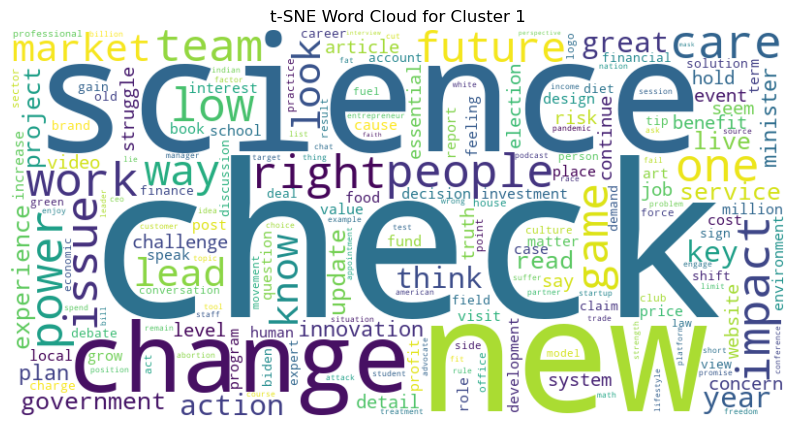

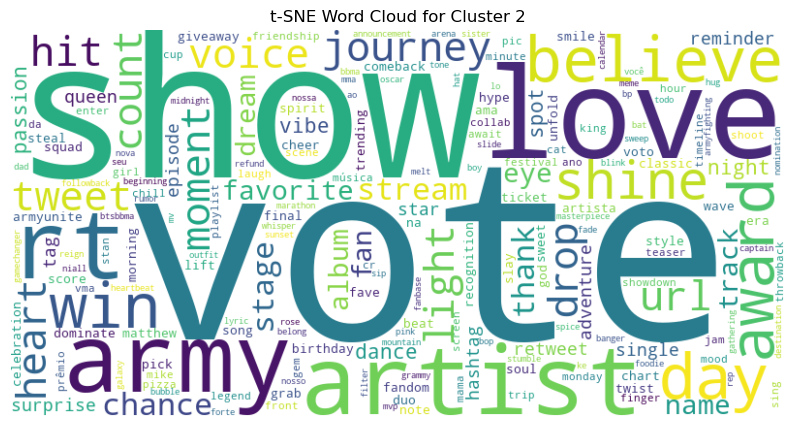

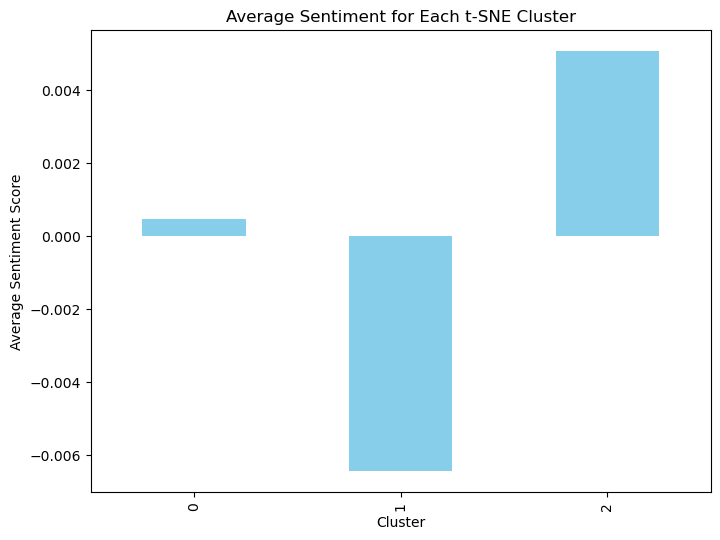

In [43]:
# T-SNE Visualization
import plotly.express as px
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import pandas as pd

# Convert T-SNE to 2D
df_tsne = pd.DataFrame(X_tsne, columns=["TSNE_1", "TSNE_2"])  # Only 2 dimensions now
df_tsne["Cluster"] = kmeans_labels_tsne
df_tsne["Text"] = words

# Step 5: Generate Word Cloud for Each Cluster
for cluster_id in range(n_clusters):
    # Get the texts belonging to the current cluster
    cluster_texts = df_tsne[df_tsne['Cluster'] == cluster_id]['Text']
    all_words = ' '.join(cluster_texts)

    # Create a word cloud for the current cluster
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_words)

    # Plot the word cloud
    plt.figure(figsize=(10, 6))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f"t-SNE Word Cloud for Cluster {cluster_id}")
    plt.show()

# Step 6: Sentiment Analysis for Each Cluster
# Using VADER Sentiment
analyzer = SentimentIntensityAnalyzer()

# Function to get average sentiment for each document in a cluster
def get_sentiment_score(text):
    return analyzer.polarity_scores(text)['compound']

# Add sentiment scores to the DataFrame
df_tsne['Sentiment'] = df_tsne['Text'].apply(get_sentiment_score)

# Visualizing average sentiment per cluster
average_sentiment = df_tsne.groupby('Cluster')['Sentiment'].mean()

# Plot average sentiment for each cluster
average_sentiment.plot(kind='bar', figsize=(8, 6), color='skyblue', title='Average Sentiment for Each t-SNE Cluster')
plt.ylabel('Average Sentiment Score')
plt.show()

# Step 8: Visualize the UMAP clusters in 2D with cluster color-coding
fig = px.scatter(df_tsne, x="TSNE_1", y="TSNE_2", color="Cluster",
                 title="TSNE Clusters with K-means",
                 hover_data={"Text": True, "Cluster": True})
fig.update_layout(
    title={
        "text": "t-SNE Clusters using K-Means",         # Title text
        "font": {"size": 20, "color": "black"},                # Font size and color
        "x": 0.5,                                             # Center align (0: left, 0.5: center, 1: right)
    }
)
fig.show()
fig.write_image("t-SNE Clusters with K-means.png")



### DBScan Clustering

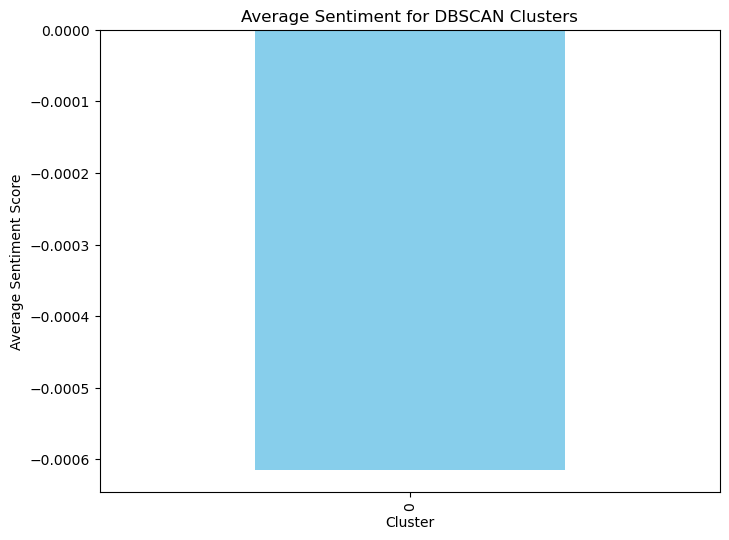

In [ ]:
import numpy as np
import pandas as pd
from sklearn.cluster import DBSCAN
import plotly.express as px
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import matplotlib.pyplot as plt

# Step 1: DBSCAN Clustering
dbscan = DBSCAN(eps=0.5, min_samples=5)  # Adjust eps and min_samples as needed
dbscan_labels_pca = dbscan.fit_predict(X_pca)

# Step 2: Create DataFrame for visualization
df_PCA_dbscan = pd.DataFrame(X_pca, columns=["PC_1", "PC_2"])
df_PCA_dbscan["Cluster"] = dbscan_labels_pca  # DBSCAN cluster labels
df_PCA_dbscan["Text"] = words

# Step 3: Sentiment Analysis for Each Cluster
analyzer = SentimentIntensityAnalyzer()

# Function to get sentiment score for each document
def get_sentiment_score(text):
    return analyzer.polarity_scores(text)['compound']

# Calculate sentiment scores
df_PCA_dbscan['Sentiment'] = df_PCA_dbscan['Text'].apply(get_sentiment_score)

# Step 4: Visualize Average Sentiment for Each Cluster
average_sentiment_dbscan = df_PCA_dbscan.groupby('Cluster')['Sentiment'].mean()
average_sentiment_dbscan.plot(kind='bar', figsize=(8, 6), color='skyblue', title='Average Sentiment for DBSCAN Clusters')
plt.ylabel('Average Sentiment Score')
plt.show()

# Step 5: Visualize Clusters with Plotly Scatter Plot
# Ensure cluster labels are treated as categories for distinct colors
df_PCA_dbscan["Cluster"] = df_PCA_dbscan["Cluster"].astype(str)

fig = px.scatter(df_PCA_dbscan, x="PC_1", y="PC_2", color="Cluster",
                 title="PCA Clusters for DBSCAN",
                 hover_data={"Text": True, "Cluster": True})
fig.show()


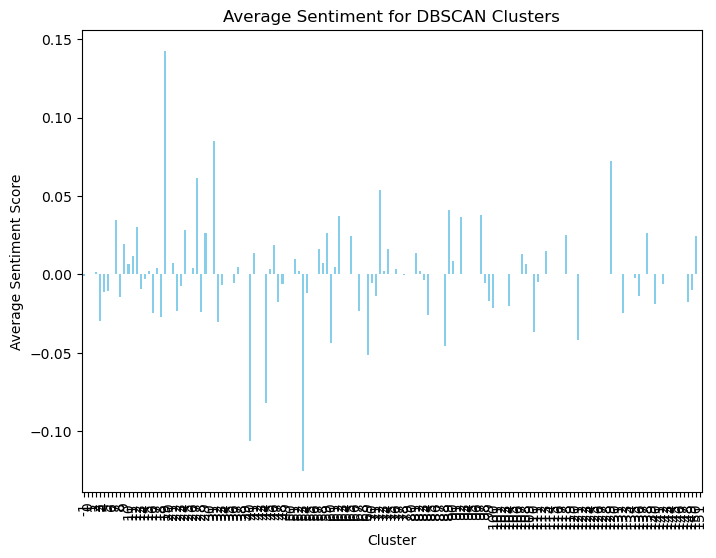

In [45]:
import numpy as np
import pandas as pd
from sklearn.cluster import DBSCAN
import plotly.express as px
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import matplotlib.pyplot as plt

# Step 1: DBSCAN Clustering
dbscan = DBSCAN(eps=1, min_samples=20)  # Adjust eps and min_samples as needed
dbscan_labels_tsne = dbscan.fit_predict(X_tsne)

# Step 2: Create DataFrame for visualization
df_TSNE_dbscan = pd.DataFrame(X_tsne, columns=["TSNE_1", "TSNE_2"])
df_TSNE_dbscan["Cluster"] = dbscan_labels_tsne  # DBSCAN cluster labels
df_TSNE_dbscan["Text"] = words

# Step 3: Sentiment Analysis for Each Cluster
analyzer = SentimentIntensityAnalyzer()

# Function to get sentiment score for each document
def get_sentiment_score(text):
    return analyzer.polarity_scores(text)['compound']

# Calculate sentiment scores
df_TSNE_dbscan['Sentiment'] = df_TSNE_dbscan['Text'].apply(get_sentiment_score)

# Step 4: Visualize Average Sentiment for Each Cluster
average_sentiment_dbscan = df_TSNE_dbscan.groupby('Cluster')['Sentiment'].mean()
average_sentiment_dbscan.plot(kind='bar', figsize=(8, 6), color='skyblue', title='Average Sentiment for DBSCAN Clusters')
plt.ylabel('Average Sentiment Score')
plt.show()

# Step 5: Visualize Clusters with Plotly Scatter Plot
# Ensure cluster labels are treated as categories for distinct colors
df_TSNE_dbscan["Cluster"] = df_TSNE_dbscan["Cluster"].astype(str)

fig = px.scatter(df_TSNE_dbscan, x="TSNE_1", y="TSNE_2", color="Cluster",
                 title="PCA Clusters for DBSCAN",
                 hover_data={"Text": True, "Cluster": True})
fig.show()

In [ ]:
import matplotlib.pyplot as plt
from matplotlib import cm
import numpy as np
from sklearn.metrics import silhouette_score, davies_bouldin_score

# Function to evaluate clustering quality
def evaluate_clustering(X, labels):
    """
    Evaluates clustering using the following metrics:
    - Silhouette Score
    - Davies-Bouldin Index
    """
    # Remove noise points (-1) for DBSCAN when evaluating metrics
    filtered_X = X[labels != -1]
    filtered_labels = labels[labels != -1]

    if len(set(filtered_labels)) > 1:  # Metrics only make sense if there are at least 2 clusters
        silhouette_avg = silhouette_score(filtered_X, filtered_labels)
        db_index = davies_bouldin_score(filtered_X, filtered_labels)
    else:
        silhouette_avg = -1  # Invalid score if only one cluster or no points left
        db_index = float('inf')  # No meaningful score for Davies-Bouldin Index with 1 cluster

    return silhouette_avg, db_index

# Evaluate K-Means Clustering for PCA
silhouette_kmeans_pca, db_index_kmeans_pca = evaluate_clustering(X_pca, kmeans_labels_pca)
print(f"K-Means Clustering Quality for PCA:")
print(f"Silhouette Score: {silhouette_kmeans_pca:.2f} (Range: -1 to 1; Higher is better)")
print(f"Davies-Bouldin Index: {db_index_kmeans_pca:.2f} (Range: 0 to ∞; Lower is better)")
print("")

# Evaluate DBSCAN Clustering for PCA
silhouette_dbscan_pca, db_index_dbscan_pca = evaluate_clustering(X_pca, dbscan_labels_pca)
print(f"DBSCAN Clustering Quality for PCA:")
print(f"Silhouette Score: {silhouette_dbscan_pca:.2f} (Range: -1 to 1; Higher is better)")
print(f"Davies-Bouldin Index: {db_index_dbscan_pca:.2f} (Range: 0 to ∞; Lower is better)")
print("")

# Evaluate K-Means Clustering for t-SNE
silhouette_kmeans_tsne, db_index_kmeans_tsne = evaluate_clustering(X_tsne, kmeans_labels_tsne)
print(f"K-Means Clustering Quality for TSNE:")
print(f"Silhouette Score: {silhouette_kmeans_tsne:.2f} (Range: -1 to 1; Higher is better)")
print(f"Davies-Bouldin Index: {db_index_kmeans_tsne:.2f} (Range: 0 to ∞; Lower is better)")
print("")

# Evaluate DBSCAN Clustering for t-SNE
silhouette_dbscan_tsne, db_index_dbscan_tsne = evaluate_clustering(X_tsne, dbscan_labels_tsne)
print(f"DBSCAN Clustering Quality for TSNE:")
print(f"Silhouette Score: {silhouette_dbscan_tsne:.2f} (Range: -1 to 1; Higher is better)")
print(f"Davies-Bouldin Index: {db_index_dbscan_tsne:.2f} (Range: 0 to ∞; Lower is better)")
print("")




K-Means Clustering Quality for PCA:
Silhouette Score: 0.44 (Range: -1 to 1; Higher is better)
Davies-Bouldin Index: 0.89 (Range: 0 to ∞; Lower is better)

DBSCAN Clustering Quality for PCA:
Silhouette Score: -1.00 (Range: -1 to 1; Higher is better)
Davies-Bouldin Index: inf (Range: 0 to ∞; Lower is better)

K-Means Clustering Quality for TSNE:
Silhouette Score: 0.38 (Range: -1 to 1; Higher is better)
Davies-Bouldin Index: 0.88 (Range: 0 to ∞; Lower is better)

DBSCAN Clustering Quality for TSNE:
Silhouette Score: 0.66 (Range: -1 to 1; Higher is better)
Davies-Bouldin Index: 0.40 (Range: 0 to ∞; Lower is better)

